In [54]:
] activate "C:\Users\Arman Angaji\OneDrive - Universität zu Köln\Dokumente\Uni-Köln\Masterarbeit\Workspace\Julia_Master\MasterProject_Julia"

 Activating environment at `C:\Users\Arman Angaji\OneDrive - Universität zu Köln\Dokumente\Uni-Köln\Masterarbeit\Workspace\Julia_Master\MasterProject_Julia\Project.toml`


In [ ]:
using Pkg: activate; activate(pwd())

using StaticArrays
using Distributions
using DataFrames
using StatsBase
using Plots
using ProgressMeter
using Statistics

include("distribution_functions.jl")

In [55]:
using TumorGrowth: DataFrame, clones_by_mutations

In [56]:
mutable struct Haplotype
    mutations :: SVector{L, Int} where L
    n :: Int
    t_birth :: Float64
end

In [57]:
#=
obs[m,1] records the parents haplotype n at birth of mutation m
obs[m,2] records the sum of n of all haplotypes containing the parents last mutation while not
         containing m
         this includes estranged parents while avoiding offspring of m
obs[m,3] records tumor size at birth of m
obs[m,4] records (first) wt size at birth of m
=#

function neutral_growth(endmut; b = log(2), d = 0.0, μ = 0.1, t= 0. )

    mutID = 0

    tumor = Vector{Haplotype}(undef, endmut)
    pushfirst!(tumor, Haplotype(SVector{0, Int}(), 1, 0. ))
    obs = Matrix{Int}(undef, endmut, 4)

    F = ones(Int, length(tumor))
    N = 1

    prog = ProgressUnknown("Progress: Mutations ")
    while mutID < endmut
        N == 0 && return neutral_growth(endmut; b = b, d = d, μ = μ, t= t )
        p = rand()*(b+d)
        m = rand(1:N)
        row = findfirst(i-> i >= m, F)
        parent = tumor[row]
        
        δt =  rand(Exponential(1.))/((b+d)*N)
        t += δt
        if p > d
            if rand() < μ
                mutID += 1
                tumor[mutID+1] = Haplotype(push(parent.mutations, mutID), 1, t )
                F[mutID+1:end] .+= 1

                obs[mutID, 1] = parent.n
                if row == 1
                    obs[mutID, 2] = N
                    obs[mutID, 4] = N
                else
                    parents = filter( h-> last(parent.mutations) in h.mutations, tumor[row:mutID])
                    obs[mutID, 2] = sum(getfield.(parents, :n))
                    
                    parents = filter( h-> first(parent.mutations) in h.mutations, tumor[2:mutID])
                    obs[mutID, 4] = sum(getfield.(parents, :n))
                end
                obs[mutID, 3] = N
            else
                parent.n += 1
                F[row:end] .+= 1
            end
            N += 1

        else
            parent.n -= 1
            F[row:end] .-= 1
            N -= 1
        end
        
        ProgressMeter.update!(prog, mutID)
    end
    return tumor, obs
end

neutral_growth (generic function with 1 method)

### RUN SIMULATION

In [199]:
b, d, μ = log(2), 0.3, 0.1
tumor, obs = neutral_growth(20000; b = b, d = d, μ = μ)

λ₀ = b - d
a₀ = b*(1-μ)
u₁ = b*μ

tumordf = DataFrame(tumor)
htypes = tumordf[2:end,:]
N, t = sum(tumordf.n), tumordf.t_birth[end]

Progress: Mutations  19983 	 Time: 0:00:41

(112812, 31.578445035646254)

In [200]:
mtypes = clones_by_mutations(tumordf)[1];

In [202]:
plot(tumordf.t_birth, 1:nrow(tumordf), ylabel=:M, xlabel=:t, yaxis=:log, lab=:none)
alive = findall(!iszero, tumordf.n)
p1 = plot!(tumordf.t_birth[alive], 1:length(alive), ylabel=:M, xlabel=:t, yaxis=:log, lab=:none)
plot!(tumordf.t_birth, t-> μ*b/λ₀*exp(λ₀*t), lab=:none)

p2 = plot(tumordf.t_birth, t-> exp(λ₀*t), lab=:none, xlabel=:t, ylabel=:N, yaxis=:log)
plot!(tumordf.t_birth[2:end], obs[:,3], label=:none)

f = mtypes .|> df -> sum(df.n)/N
# f = exp(-λ*t_birth)
p3 = scatter(htypes.t_birth, -log.(f) ./ (b-d), alpha = 0.2)
plot!(htypes.t_birth, x->x, c=:black, lw = 2., legend=:none, xlabel=:t, ylabel="- log(f) / λ")

plot(p1, p2, p3)

### n Parents at birth

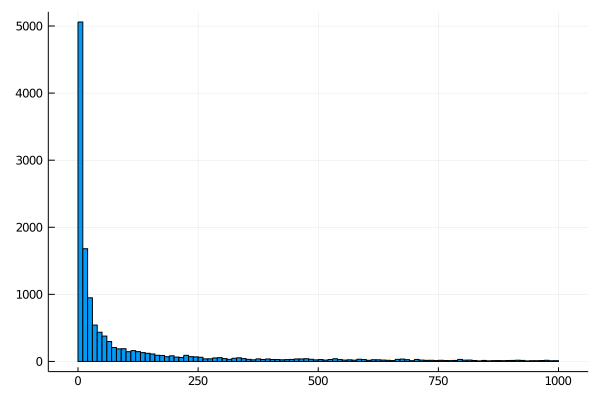

In [66]:
histogram(filter(n-> n<1000, obs[:,1]), lab="")

In [10]:
h = fit(Histogram, filter(c-> c.t_birth< t - 0. && !iszero(c.n), tumordf).n , nbins=maximum(tumordf.n))
bar(midpoints(h.edges[1]), h.weights ./ sum(h.weights), lab="htype n dist", xlims=(0,50) )
pn = [1/n^2 for n=1:100]
plot!(1:100, pn/sum(pn), lab="estimate", xlabel="n" )

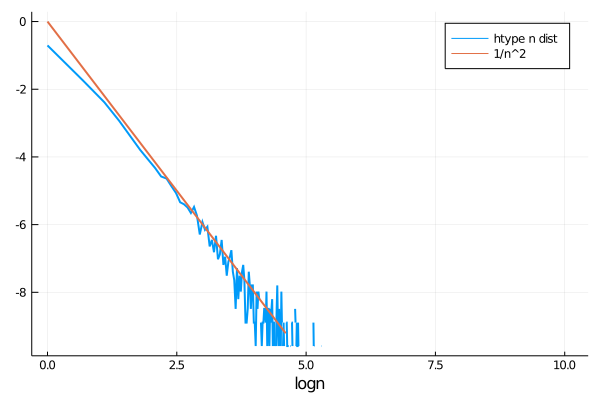

In [26]:
plot(log.(h.edges[1][1:end-1]), log.(h.weights ./ sum(h.weights) ), lw=2., lab="htype n dist")
plot!(log.(1:0.2:100), n-> -2*n, lab="1/n^2", xlabel=:logn, lw=2. )

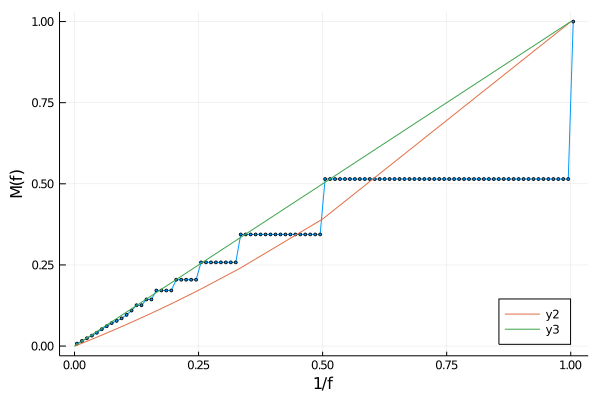

In [68]:
M(tumordf.n; normalize=true)
cum= [sum(1/n^2 for n=np:1000) for np=1:1000]
plot!(1 ./ collect(1:1000), cum/ (π^2/6) )
plot!(0.:0.1:1., x-> x)

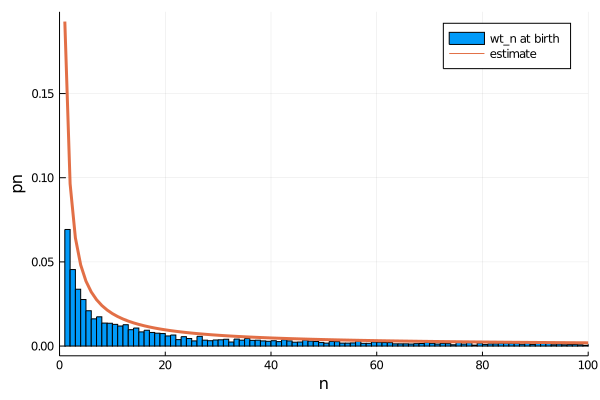

In [13]:
pn = [ 1/n for n=1:100]
pn ./= sum(pn)

n_orph = obs[ htypes.t_birth .< t - 2. ,1]
histogram(n_orph, nbins = maximum(n_orph), normalize=true, lab="wt_n at birth", xlims=(0,100) )

plot!(pn, lab="estimate", lw=3., xlabel=:n, ylabel=:pn)

In [101]:
typetwos = filter(c-> ( length(c.mutations)>1 && c.t_birth < (t - 3.)), htypes)
n_orph = filter(n-> n<1000, obs[last.(typetwos.mutations), 2] )
hist_orph = fit(Histogram, n_orph, nbins=maximum(n_orph), closed=:left)
n_estr = filter(n-> n<1000, obs[last.(typetwos.mutations), 1] )
hist_estr = fit(Histogram, n_estr, nbins=maximum(n_estr), closed=:left);

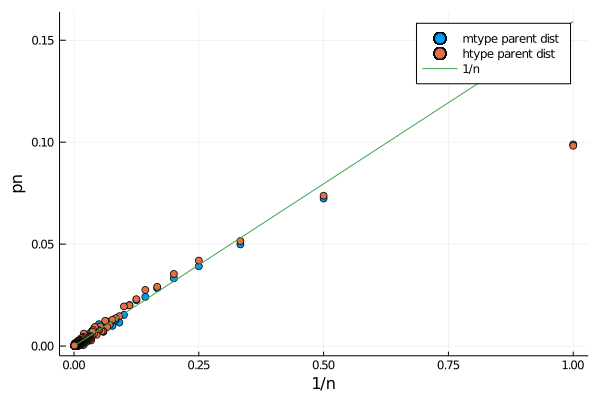

In [104]:
scatter(1 ./ hist_orph.edges[1][1:end-1], hist_orph.weights/sum(hist_orph.weights), lab = "mtype parent dist")
scatter!(1 ./ hist_estr.edges[1][1:end-1], hist_estr.weights/sum(hist_estr.weights), lab = "htype parent dist")

pn = [ 1/n for n=1:300]
plot!(1 ./ collect(1:300), pn/sum(pn), lab="1/n", xlabel="1/n", ylabel="pn" )

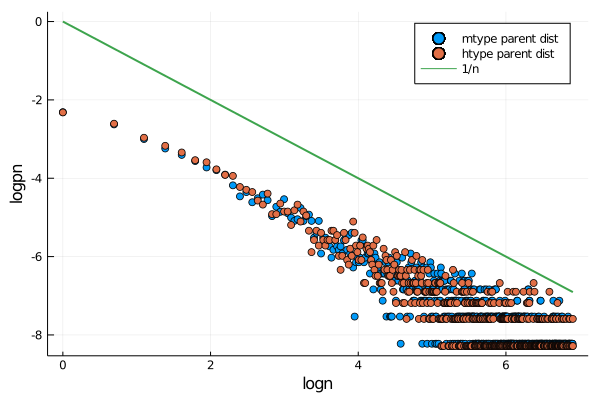

In [105]:
scatter(log.(hist_orph.edges[1][1:end-1]), log.( hist_orph.weights/sum(hist_orph.weights) ), lab = "mtype parent dist")
scatter!(log.( hist_estr.edges[1][1:end-1] ), log.( hist_estr.weights/sum(hist_estr.weights)), lab = "htype parent dist")
plot!(log.( hist_estr.edges[1][1:end-1] ), n-> -n, lab="1/n", lw=2., xlab=:logn, ylab=:logpn)

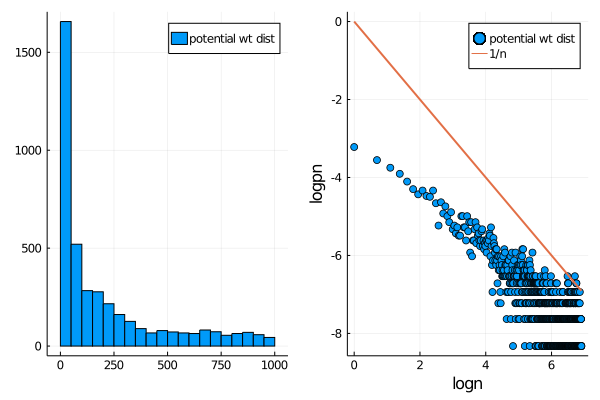

In [215]:
typetwos = filter(c-> ( length(c.mutations)>1 && c.t_birth < (t - 2.)), htypes)
n_corr = filter(n-> n<1000, obs[last.(typetwos.mutations), 4] )
hist_corr = fit(Histogram, n_corr, nbins=maximum(n_corr), closed=:left)

p1 = histogram(n_corr, lab = "potential wt dist")

p2 = scatter(log.(hist_corr.edges[1][1:end-1]), log.( hist_corr.weights/sum(hist_corr.weights) ), lab = "potential wt dist")
plot!(log.( hist_corr.edges[1][1:end-1] ), n-> -n, lab="1/n", lw=2., xlab=:logn, ylab=:logpn)

plot(p1, p2)

In [176]:
firstms = htypes.mutations .|> first |> unique
firstm = firstms[4]

4

In [177]:
typetwos = filter(c-> ( first(c.mutations) == firstm && length(c.mutations)>1 && c.t_birth < (t - 0.)), htypes)
n_corr = filter(n-> n<2000, obs[last.(typetwos.mutations), 4] )
hist_corr = fit(Histogram, n_corr, nbins=maximum(n_corr), closed=:left)
length(n_corr)

335

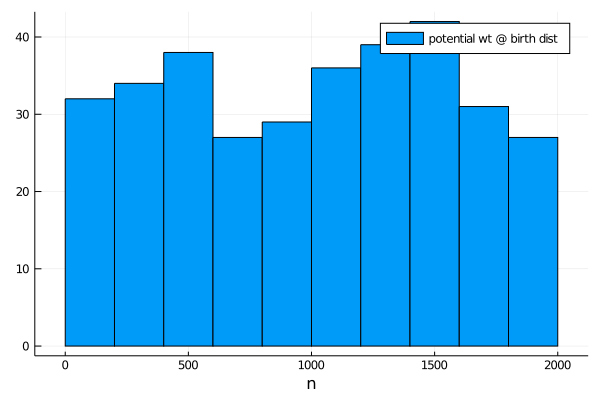

In [178]:
histogram(n_corr, lab = "potential wt @ birth dist", nbins = 15, xlab=:n)

3.8779495524816925


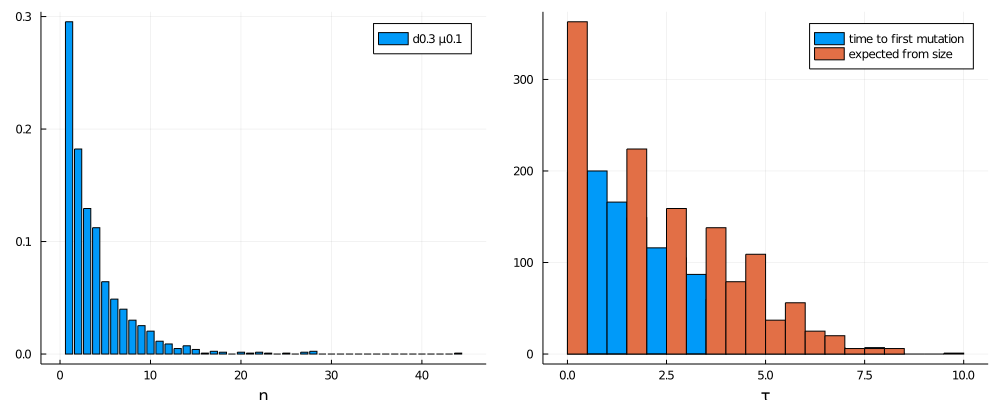

In [55]:
typetwos = filter(c-> ( length(c.mutations)>1 && c.t_birth < (t - 3.)), tumor)
parentmuts = [ muts[end-1] for muts in getfield.(typetwos,:mutations) ]
parents = [tumor[2:end][m] for m in parentmuts ]
firsts = [ !(h in parents[1:r-1]) for (r,h) in enumerate(parents)]

ms = last.(DataFrame(typetwos[firsts]).mutations)
mean(obs[ms,1]) |> println
hist = fit(Histogram,obs[ms, 1], nbins=maximum(obs[ms,1]) )
pn = bar(midpoints(hist.edges[1]).-0.5, hist.weights/sum(hist.weights), lab="d$d μ$μ", xlabel=:n, normalize=true)

pt = histogram(DataFrame(typetwos[firsts]).t_birth .-  DataFrame(parents[firsts]).t_birth, nbins=30, xlabel=:τ, fill=false, lab="time to first mutation")
histogram!(log.(obs[ms, 1])/λ₀, nbins=40, lab="expected from size")
plot(pn, pt, size=(1000,400))

### EXTINCTION

In [56]:
x = filter(c-> c.t_birth < (t - 5.), tumordf)
count(iszero, x.n) |> println
d/(b*(1-μ)) * nrow(x) |> println

1241
1353.7288467008107


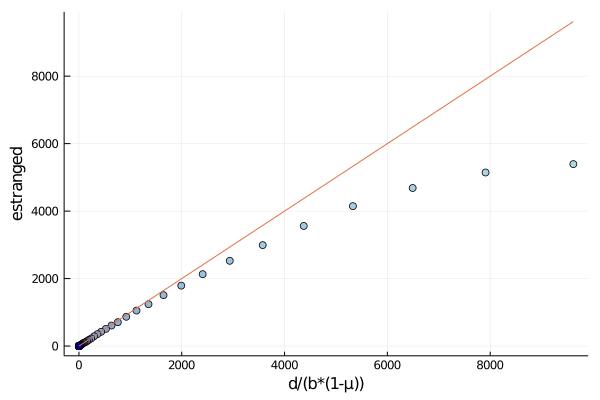

In [57]:
trange = 0.:0.5:t
expected = Vector{Float64}(undef, length(trange))
found = Vector{Int}(undef, length(trange))
for (i,Δt) in enumerate(trange)
    x = filter(c-> c.t_birth < (t - Δt), tumordf)

    expected[i] = d/(b*(1-μ)) * nrow(x)
    found[i] = count(iszero, x.n)
end
scatter(expected, found,
    xlabel="d/(b*(1-μ))", ylabel=:estranged, c=cgrad(:blues)[trange/t])
plot!(expected, expected, legend=:none)

### ESTRANGED

In [203]:
typetwos = filter(c-> ( length(c.mutations)>1 && c.t_birth < (t - 5.)), htypes)
parents_n = [htypes.n[m] for m in (muts[end-1] for muts=typetwos.mutations) ]
parents_at_birth = obs[last.(typetwos.mutations),1]

# extinction probs
p₀ = ( d/(b*(1-μ)) ).^parents_at_birth

# expected estranged
sum( p₀ ) |> println
# actual estranged
count(iszero, parents_n) |> println

134.2080635540628
115


In [204]:
mean(parents_at_birth[ iszero.(parents_n) ]) |> println
-1/log(d/(b*(1-μ))) |> println

1.5739130434782609
1.3659347946355849


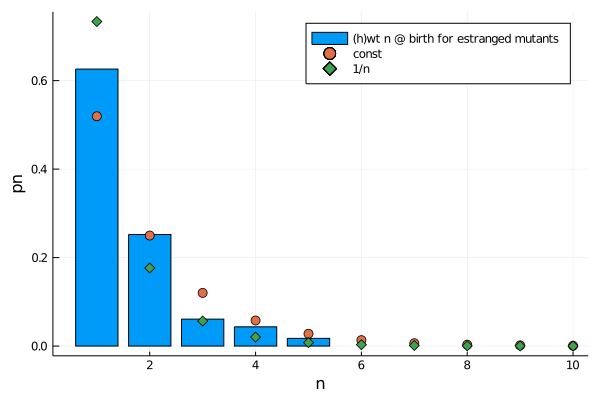

In [205]:
h = fit(Histogram, parents_at_birth[ iszero.(parents_n) ],
    nbins=maximum(parents_at_birth[ iszero.(parents_n)]))
bar(midpoints(h.edges[1]).-0.5, h.weights ./sum(h.weights), xlabel=:n, ylab=:pn, label="(h)wt n @ birth for estranged mutants")

# nrange = 1:10
# pn = nrange .|> n->(d/(b*(1-μ)))^n * n
# scatter!(nrange, pn./sum(pn), ms=5.)

nrange = 1:10
pn = nrange .|> n->(d/(b*(1-μ)))^n
scatter!(nrange, pn./sum(pn), ms=5., lab="const")

pn = [ 1/n for n=nrange]
pn .*= nrange .|> n->(d/(b*(1-μ)))^n
scatter!(nrange, pn./sum(pn), ms=5., marker=:d, lab="1/n")

In [89]:
h_all = fit(Histogram, parents_at_birth, nbins=maximum(parents_at_birth))
sum( (d/(b*(1-μ)))^n * h_all.weights[n] for n=1:length(h_all.weights))

127.99139292672466

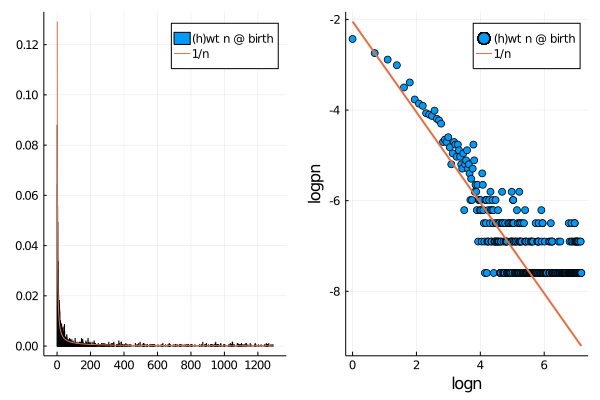

In [213]:
h_all = fit(Histogram, filter(n -> n<10000, parents_at_birth), nbins=maximum(parents_at_birth))
xn = h_all.edges[1][1:end-1]
p1 = bar(xn, h_all.weights/sum(h_all.weights), label="(h)wt n @ birth")

pn = [ 1/n for n=h_all.edges[1][1:end-1]]
pn ./= sum(pn)
plot!(xn, pn, lab="1/n")

p2 = scatter(log.(xn), log.(h_all.weights/sum(h_all.weights)), label="(h)wt n @ birth" )
plot!(log.(xn), log.(pn/sum(pn)), lab="1/n", xlabel=:logn, ylabel=:logpn, lw=2. )

plot(p1, p2)

In [214]:
pn = [ 1/n for n=1:500]
pn ./= sum(pn)
    
q = d/(b*(1-μ))
sum( q^n * pn[n] for n=1:length(pn))*nrow(typetwos)

191.981862302463

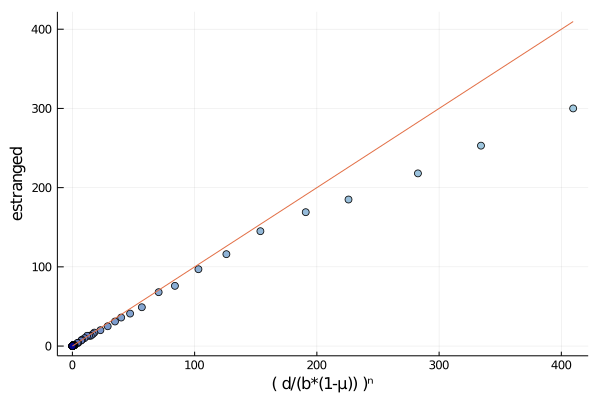

In [243]:
trange = 2.:0.5:t
expected = Vector{Float64}(undef, length(trange))
found = Vector{Int}(undef, length(trange))
for (i,Δt) in enumerate(trange)
    typetwos = filter(c-> ( length(c.mutations)>1 && c.t_birth < (t - Δt)), htypes)
    parents_n = [htypes.n[m] for m in (muts[end-1] for muts=typetwos.mutations) ]
    parents_at_birth = obs[last.(typetwos.mutations),1]
    p₀ = ( d/(b*(1-μ)) ).^parents_at_birth

    expected[i] = sum( p₀ )
    found[i] = count(iszero, parents_n)
end
scatter(expected, found,
    xlabel="( d/(b*(1-μ)) )ⁿ", ylabel=:estranged, c=cgrad(:blues)[trange/t])
plot!(expected, expected, legend=:none)

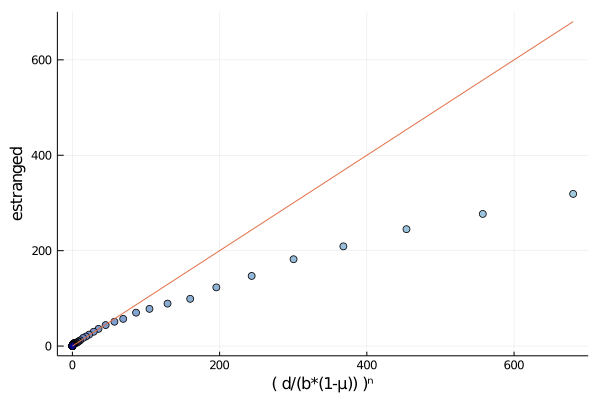

In [98]:
trange = 2.:0.5:t
expected = Vector{Float64}(undef, length(trange))
found = Vector{Int}(undef, length(trange))
for (i,Δt) in enumerate(trange)
    typetwos = filter(c-> ( length(c.mutations)>1 && c.t_birth < (t - Δt)), htypes)
    parents_n = [htypes.n[m] for m in (muts[end-1] for muts=typetwos.mutations) ]    
    
    pn = [ 1/n for n=1:500]
    pn ./= sum(pn)
    
    q = d/(b*(1-μ))
    expected[i] = sum( q^n * pn[n] for n=1:length(pn))*nrow(typetwos)
    found[i] = count(iszero, parents_n)
end
scatter(expected, found,
    xlabel="( d/(b*(1-μ)) )ⁿ", ylabel=:estranged, c=cgrad(:blues)[trange/t])
plot!(expected, expected, legend=:none)

Progress: 47 /  47 	 Time: 0:00:05

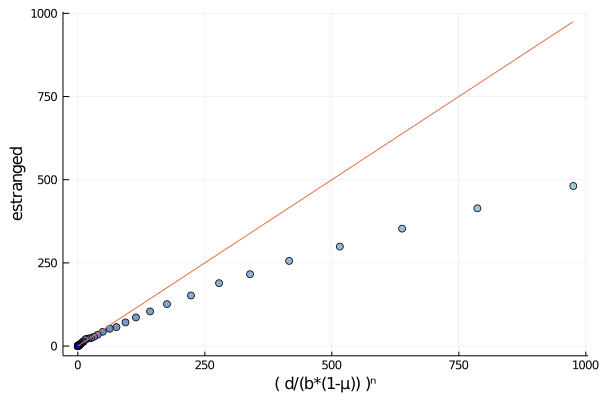

In [35]:
trange = 2.:0.5:t
expected = Vector{Float64}(undef, length(trange))
found = Vector{Int}(undef, length(trange))
prog = ProgressUnknown("Progress: $(length(trange)) / ")
for (i,Δt) in enumerate(trange)
    typetwos = filter(c-> ( length(c.mutations)>1 && c.t_birth < (t - Δt)), htypes)
    parents_n = [htypes.n[m] for m in (muts[end-1] for muts=typetwos.mutations) ]   
        
    q = d/(b*(1-μ))

    ntot = mean(tumordf.n)/(1- exp(d-b))
    po = q^(-1/log(q)) / (-log(q) * ntot)
    pno = mean(tumordf.n)/ntot
    
    expected[i] = po / (po + pno) * nrow(typetwos)
    found[i] = count(iszero, parents_n)
    sleep(0.1)
    ProgressMeter.update!(prog, i)
end
scatter(expected, found,
    xlabel="( d/(b*(1-μ)) )ⁿ", ylabel=:estranged, c=cgrad(:blues)[trange/t])
plot!(expected, expected, legend=:none)

Progress: 47 /  47 	 Time: 0:00:05

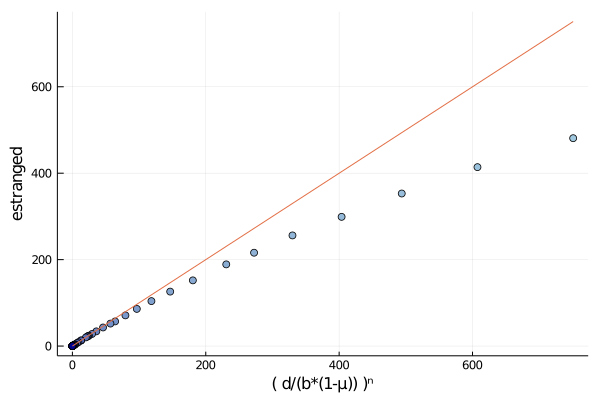

In [80]:
trange = 2.:0.5:t
expected = Vector{Float64}(undef, length(trange))
found = Vector{Int}(undef, length(trange))
prog = ProgressUnknown("Progress: $(length(trange)) / ")
for (i,Δt) in enumerate(trange)
    typetwos = filter(c-> ( length(c.mutations)>1 && c.t_birth < (t - Δt)), htypes)
    parents_n = [htypes.n[m] for m in (muts[end-1] for muts=typetwos.mutations) ]   
        
    q = d/(b*(1-μ))

    po_n = parents_n .|> n -> begin 
        po = q^(-1/log(q)) / (-log(q))
        po / (po + n)
    end
    
    expected[i] = ( isempty(po_n) ? 1. : mean(po_n) ) * nrow(typetwos)
    found[i] = count(iszero, parents_n)
    sleep(0.1)
    ProgressMeter.update!(prog, i)
end
scatter(expected, found,
    xlabel="( d/(b*(1-μ)) )ⁿ", ylabel=:estranged, c=cgrad(:blues)[trange/t])
plot!(expected, expected, legend=:none)

In [36]:
# savefig("estranged_po_estimate_vary_mutation_age.png")

### ORPHANED

In [244]:
typetwos = filter(c-> (length(c.mutations)>1 && c.t_birth < (t - 5.)), htypes)
parents_n = similar(typetwos.n)
for (i, ms) in enumerate(typetwos.mutations)
    parents = filter(h-> (ms[end-1] in h.mutations) && !issubset(ms,h.mutations), htypes[ms[end-1]:end, :])
    parents_n[i] = sum(parents.n)
end
parents_at_birth = obs[last.(typetwos.mutations),2]

p₀ = ( d/b ).^parents_at_birth

# expected orphaned
sum( p₀ ) |> println
# actual orphaned
count(iszero, parents_n) |> println

97.31804613692589
96


In [245]:
mean(parents_at_birth[ iszero.(parents_n) ]) |> println
-1/log(d/b) |> println

1.3958333333333333
1.1940870475240124


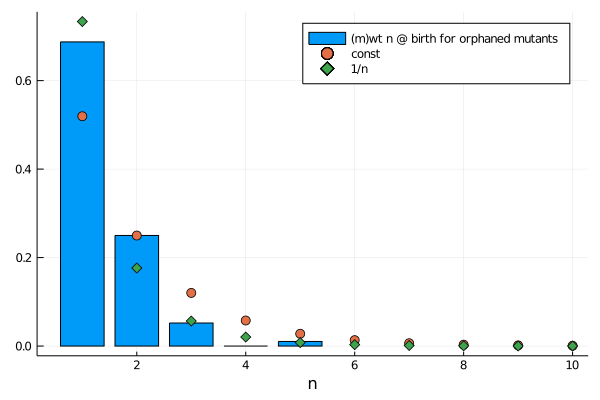

In [246]:
h = fit(Histogram, parents_at_birth[ iszero.(parents_n) ],
    nbins=maximum(parents_at_birth[ iszero.(parents_n)]))
bar(midpoints(h.edges[1]).-0.5, h.weights ./sum(h.weights), xlabel=:n, label="(m)wt n @ birth for orphaned mutants")

# nrange = 1:10
# pn_p = nrange .|> n->(d/b)^n * n
# scatter!(nrange, pn_p./sum(pn_p), ms=5.)

nrange = 1:10
pn = nrange .|> n->(d/(b*(1-μ)))^n
scatter!(nrange, pn./sum(pn), ms=5., lab="const")

pn = [ 1/n for n=nrange]
pn .*= nrange .|> n->(d/(b*(1-μ)))^n
scatter!(nrange, pn./sum(pn), ms=5., marker=:d, lab="1/n")

In [187]:
sum(nrange.*pn)

0.9257921405217793

In [188]:
pn = [ 1/n for n=1:500]
pn ./= sum(pn)
    
q = d/b
sum( q^n * pn[n] for n=1:length(pn))*nrow(typetwos)

167.95980850878541

Progress: 57 /  57 	 Time: 0:00:06

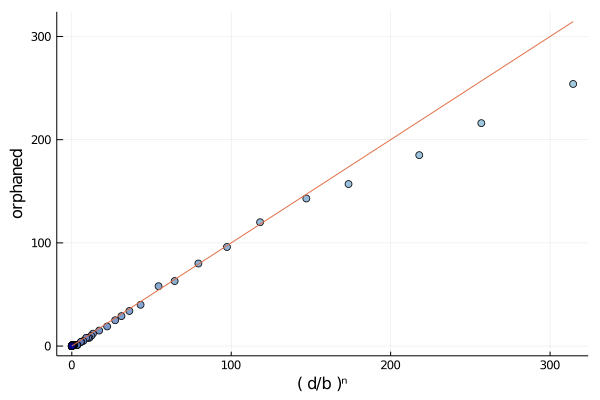

In [247]:
trange = 2.:0.5:t
expected = Vector{Float64}(undef, length(trange))
found = Vector{Int}(undef, length(trange))
prog = ProgressUnknown("Progress: $(length(trange)) / ")
for (i,Δt) in enumerate(trange)
    typetwos = filter(c-> ( length(c.mutations)>1 && c.t_birth < (t - Δt)), htypes)
    parents_n = typetwos.mutations .|> m->mtypes[m[end-1]] |> df -> sum(df.n)
    parents_n .-= mtypes[last.(typetwos.mutations)] .|> df -> sum(df.n)
    
    parents_at_birth = obs[last.(typetwos.mutations),2]
    p₀ = ( d/b ).^parents_at_birth

    expected[i] = sum( p₀ )
    found[i] = count(iszero, parents_n)
    sleep(0.1)
    ProgressMeter.update!(prog, i)
end
scatter(expected, found,
    xlabel="( d/b )ⁿ", ylabel=:orphaned, c=cgrad(:blues)[trange/t])
plot!(expected, expected, legend=:none)

Progress: 57 /  57 	 Time: 0:00:06

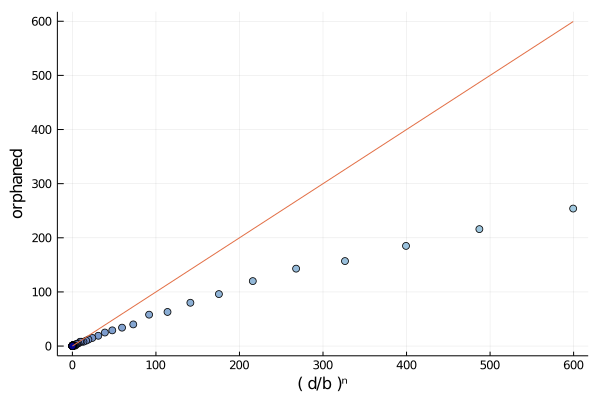

In [248]:
trange = 2.:0.5:t
expected = Vector{Float64}(undef, length(trange))
found = Vector{Int}(undef, length(trange))
prog = ProgressUnknown("Progress: $(length(trange)) / ")
for (i,Δt) in enumerate(trange)
    typetwos = filter(c-> ( length(c.mutations)>1 && c.t_birth < (t - Δt)), htypes)
    parents_n = typetwos.mutations .|> m->mtypes[m[end-1]] |> df -> sum(df.n)
    parents_n .-= mtypes[last.(typetwos.mutations)] .|> df -> sum(df.n)
    
    pn = [ 1/n for n=1:500]
    pn ./= sum(pn)
    
    q = d/b
    expected[i] = sum( q^n * pn[n] for n=1:length(pn))*nrow(typetwos)
    found[i] = count(iszero, parents_n)
    sleep(0.1)
    ProgressMeter.update!(prog, i)
end
scatter(expected, found,
    xlabel="( d/b )ⁿ", ylabel=:orphaned, c=cgrad(:blues)[trange/t])
plot!(expected, expected, legend=:none)

Progress: 61 /  61 	 Time: 0:00:06

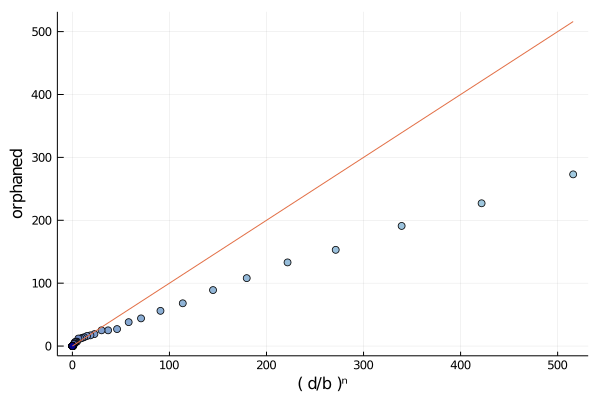

In [202]:
trange = 2.:0.5:t
expected = Vector{Float64}(undef, length(trange))
found = Vector{Int}(undef, length(trange))
prog = ProgressUnknown("Progress: $(length(trange)) / ")
for (i,Δt) in enumerate(trange)
    typetwos = filter(c-> ( length(c.mutations)>1 && c.t_birth < (t - Δt)), htypes)
    parents_n = typetwos.mutations .|> m->mtypes[m[end-1]] |> df -> sum(df.n)
    parents_n .-= mtypes[last.(typetwos.mutations)] .|> df -> sum(df.n)
    
   
    q = d/b

    ntot = mean(tumordf.n)/(1- exp(d-b))
    po = q^(-1/log(q)) / (-log(q) * ntot)
    pno = mean(tumordf.n)/ntot
    
    expected[i] = po / (po + pno) * nrow(typetwos)
    found[i] = count(iszero, parents_n)
    sleep(0.1)
    ProgressMeter.update!(prog, i)
end
scatter(expected, found,
    xlabel="( d/b )ⁿ", ylabel=:orphaned, c=cgrad(:blues)[trange/t])
plot!(expected, expected, legend=:none)

In [27]:
firstms = first.(htypes.mutations) |> unique!

po = Float64[]
countorphs = Int[]
for firstm in firstms
    mtype = mtypes[firstm]

    typetwos = filter(c-> (length(c.mutations)>1 && c.t_birth < (t - 2.)), mtype)
    isempty(typetwos) && continue
    parents_n = sum(mtype.n) .- sum.( getproperty.( mtypes[last.(typetwos.mutations)],:n) )
    parents_at_birth = obs[last.(typetwos.mutations),4]

    push!(po, sum( ( d/b ).^parents_at_birth ) )

    push!(countorphs, count(iszero, parents_n))
end

In [28]:
countorphs |> sum

130

In [29]:
po |> sum

148.24589747434572

Progress: 79 /  79 	 Time: 0:00:11

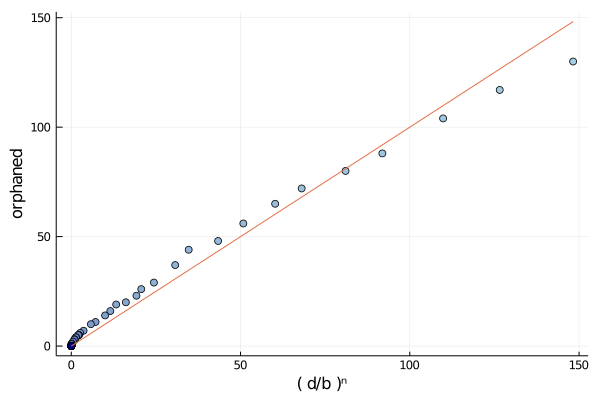

In [30]:
firstm = firstms[4]

trange = 2.:0.5:t
expected = Vector{Float64}(undef, length(trange))
found = Vector{Int}(undef, length(trange))
prog = ProgressUnknown("Progress: $(length(trange)) / ")
for (i,Δt) in enumerate(trange)

    po = Float64[]
    countorphs = Int[]
    for firstm in firstms
        mtype = mtypes[firstm]

        typetwos = filter(c-> (length(c.mutations)>1 && c.t_birth < (t - Δt)), mtype)
        isempty(typetwos) && continue
        parents_n = sum(mtype.n) .- sum.( getproperty.( mtypes[last.(typetwos.mutations)],:n) )
        parents_at_birth = obs[last.(typetwos.mutations),4]

        push!(po, sum( ( d/b ).^parents_at_birth ) )

        push!(countorphs, count(iszero, parents_n))
    end

    expected[i] = sum( po )
    found[i] = sum(countorphs)
    sleep(0.1)
    ProgressMeter.update!(prog, i)
end
scatter(expected, found,
    xlabel="( d/b )ⁿ", ylabel=:orphaned, c=cgrad(:blues)[trange/t])
plot!(expected, expected, legend=:none)

In [33]:
q = d/b
sum( q^n for n=1:1000)/(sum( q^n + (1-q^n) for n=1:1000))

0.0007630730037863196

In [47]:
firstm = firstms[4]

trange = 5.:0.5:t
expected = Vector{Float64}(undef, length(trange))
found = Vector{Float64}(undef, length(trange))
prog = ProgressUnknown("Progress: $(length(trange)) / ")
for (i,Δt) in enumerate(trange)
    
    nexpected = 0
    countorphs = 0.
    for firstm in firstms
        mtype = mtypes[firstm]

        typetwos = filter(c-> (length(c.mutations)>1 && c.t_birth < (t - Δt)), mtype)
        isempty(typetwos) && continue
        parents_n = sum(mtype.n) .- sum.( getproperty.( mtypes[last.(typetwos.mutations)],:n) )

        nexpected += nrow(typetwos)
        countorphs += count(iszero, parents_n)#/nrow(typetwos)
    end

    q = d/b
    expected[i] = sum( q^n*1/n for n=1:1000)/(sum( (q^n + (1-q^n))*1/n for n=1:1000))*nexpected
    found[i] = countorphs
    sleep(0.1)
    ProgressMeter.update!(prog, i)
end

Progress: 73 /  73 	 Time: 0:00:10

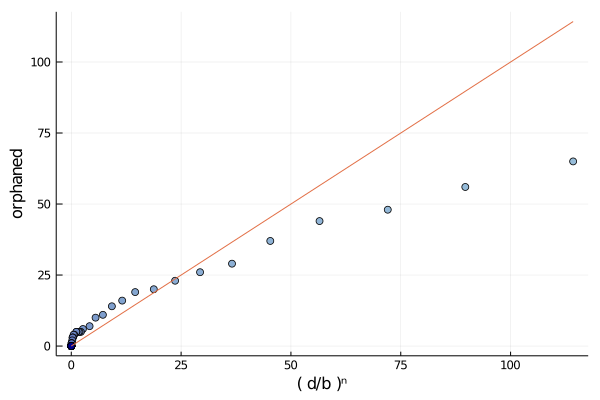

In [48]:
scatter(expected, found,
    xlabel="( d/b )ⁿ", ylabel=:orphaned, c=cgrad(:blues)[trange/t])
plot!(expected, expected, legend=:none)

### First mutants

4.066096866096866


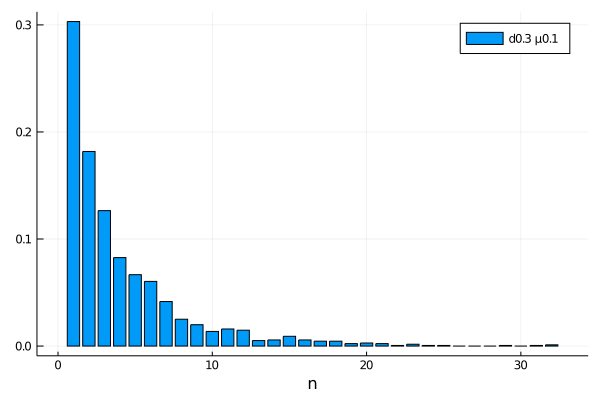

In [103]:
typetwos = filter(c-> ( length(c.mutations)>1 && c.t_birth < (t - 2.)), tumor)
parentmuts = [ muts[end-1] for muts in getfield.(typetwos,:mutations) ]
parents = [tumor[2:end][m] for m in parentmuts ]
firsts = [ !(h in parents[1:r-1]) for (r,h) in enumerate(parents)]

ms = last.(DataFrame(typetwos[firsts]).mutations)
mean(obs[ms,1]) |> println
hist = fit(Histogram,obs[ms, 1], nbins=maximum(obs[ms,1]) )
pn = bar(midpoints(hist.edges[1]).-0.5, hist.weights/sum(hist.weights), lab="d$d μ$μ", xlabel=:n, normalize=true)

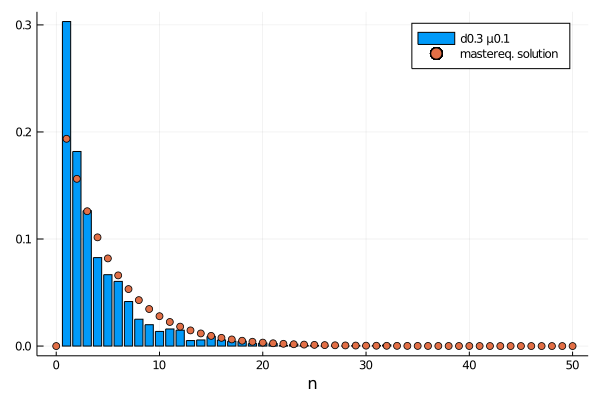

In [104]:
nmax=50
pvec=zeros(nmax+1)
qvec=zeros(nmax+1)
delpvec=zeros(nmax+1)
pvec[1+1]=1.
delt=0.001


for time in 0:delt:50

    delpvec[0+1] = d*pvec[1+1]
    for n in 1:nmax-1
        delpvec[n+1]= ( b*(n-1)*(1-μ)* pvec[n-1+1] 
                     - d*n*pvec[n+1]
                     - b*(1-μ)*(n) *pvec[n+1]
                     + d*(n+1) * pvec[n+1+1] 
                     - μ*b*n * pvec[n+1] )
    end
    delpvec[nmax+1] = ( b*(1-μ)*(nmax-1) * pvec[nmax-1+1]
                     - d*nmax * pvec[nmax+1]
                     - b*(1-μ)*(nmax) * pvec[nmax+1] 
                     - μ*b*nmax * pvec[nmax+1] )

    pvec += delt*delpvec
    
    for n in 0:nmax
        qvec[n+1] += delt*μ*b*n*pvec[n+1]
    end

end
qvec/=sum(qvec);
scatter!(0:nmax, qvec, lab="mastereq. solution")

In [73]:
# master equation result

In [82]:
q = d/(b*(1-μ))
sum( q^n * qvec[n+1] for n=0:length(qvec)-1)

0.1272466661608223

In [83]:
# heuristic

In [84]:
weight_orphan = sum( μ*(1-μ)^( b/(b-d)*(m-1) )*q^m for m=1:100)
weight_noorphan = sum( μ*(1-μ)^( b/(b-d)*(m-1) )*(1-q^m) for m=1:100)

weight_orphan/(weight_orphan+weight_noorphan)

0.13573269591994197

In [85]:
# orphaned first mutants

In [86]:
count(iszero, getfield.(parents[firsts],:n) ) / sum(firsts)

0.15840455840455842

### clone turnover

In [56]:
b, μ = 1., 0.1
drange = 0.0:0.05:0.9
reps = 80

expectorph = zeros(Float64, length(drange), reps)

countorph = zeros(Float64, length(drange), reps)

for (i,dp)=enumerate(drange)
    q = dp/b
    
    for j in 1:reps
        out = neutral_growth(Ncutoff ; b = b, d = dp, μ = μ)
        out = neutral_growth!(out[1], out[2], N; Nthresh= Ncutoff,  b = b, d = dp, μ = μ, t=out[4])
        tumor = DataFrame(out[1])
        obs = out[2][:, 2]
        mtypes = clones_by_mutations(tumor)[1]
        freqs = sum.(getproperty.(mtypes,:n))
        
        daughters = filter(h -> length(h.mutations)>1 && freqs[last(h.mutations)] > 0, tumor)# && freqs[last(h.mutations)] > N/Ncutoff, tumor)
        
        parents_n = [ sum(mtypes[muts[end-1]].n) - sum(mtypes[last(muts)].n) for muts in daughters.mutations ]
        
        parents_at_birth = obs[last.(daughters.mutations)]
        
        if !isempty(parents_n)
            expectorph[i,j] = mean( q.^parents_at_birth )
            countorph[i,j] = count(iszero, parents_n) / length(parents_n)
        end
    end
    
    print("d",dp," ")
    sleep(0.1)
end

d0.0 d0.05 d0.1 d0.15 d0.2 d0.25 d0.3 d0.35 d0.4 d0.45 d0.5 d0.55 d0.6 d0.65 d0.7 d0.75 d0.8 

Progress: N  3716 	 Time: 0:00:00

d0.85 

Progress: N  3158 	 Time: 0:00:00

d0.9 

Progress: N  3227 	 Time: 0:00:00

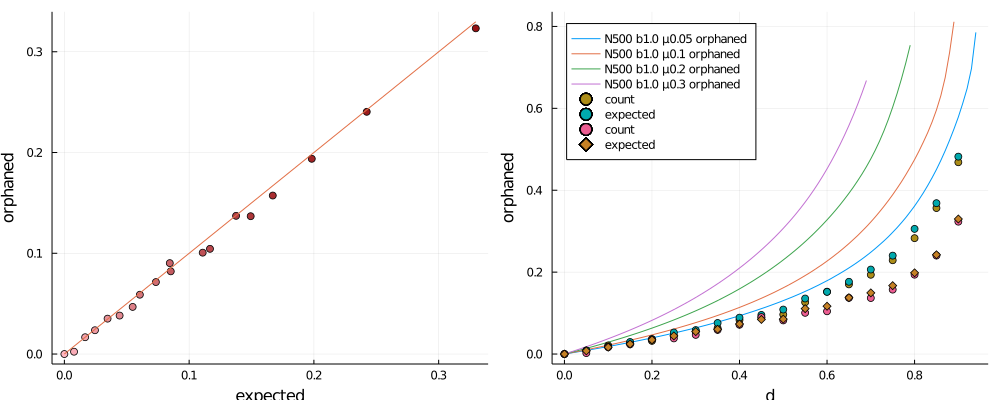

In [57]:
mcount, Δcount = [mean(countorph[i,:]) for i=1:size(countorph,1)], [std(countorph[i,:]) for i=1:size(countorph,1)]
mexp, Δexp = [mean(expectorph[i,:]) for i=1:size(expectorph,1)], [std(expectorph[i,:]) for i=1:size(expectorph,1)]

p1 = scatter(mexp, mcount, c=cgrad(:reds)[drange])
plot!(mexp, mexp, legend=:none, ylab=:orphaned, xlab=:expected)

p2 = scatter!(p_orph, drange, mcount, lab="count μ$μ", xlab=:d, ylab=:orphaned, legend=:topleft)
scatter!(p_orph, drange, mexp, lab="expected μ$μ", xlab=:d, ylab=:orphaned, legend=:topleft, marker=:d)

plot(p1,p2, size=(1000, 400))

### haplotype parent, orphaned

In [101]:
b, μ = 1., 0.2
drange = 0.0:0.05:0.9

reps = 50
expectorph = zeros(Float64, length(drange), reps)

countorph = zeros(Float64, length(drange), reps)

for (i,dp)=enumerate(drange)
    q = dp/b
    
    n=1
    while n<=reps
        out = neutral_growth(Ncutoff; b = b, d = dp, μ = μ)
        out = neutral_growth!(out[1], out[2], N; Nthresh= Ncutoff,  b = b, d = dp, μ = μ, t=out[4])
        tumor = DataFrame(out[1])
        obs = out[2][:, 1]
        mtypes = clones_by_mutations(tumor)[1]
#         freqs = sum.(getproperty.(mtypes,:n)) ./ N
        
        daughters = filter(h -> length(h.mutations)>1 && sum(mtypes[last(h.mutations)].n) > 0, tumor)# && freqs[last(h.mutations)] > 1/Ncutoff, tumor)
        
        parents_n = [ sum(filter(h-> all(h.mutations[length(muts):end] .> last(muts)), mtypes[muts[end-1]]).n) for muts in daughters.mutations ]
        
        parents_at_birth = obs[last.(daughters.mutations)]
        
        if !isempty(parents_n)
            expectorph[i,n] = mean( q.^parents_at_birth )
            
            countorph[i,n] = count(iszero, parents_n) / length(parents_n)
            n+=1
        end
    end
    
    print("d",dp," ")
    sleep(0.1)
end

d0.0 d0.05 d0.1 d0.15 d0.2 d0.25 d0.3 d0.35 d0.4 d0.45 d0.5 d0.55 d0.6 d0.65 d0.7 d0.75 

Progress: N  1127 	 Time: 0:00:00

d0.8 

Progress: N  3652 	 Time: 0:00:00

d0.85 

Progress: N  2864 	 Time: 0:00:00

d0.9 

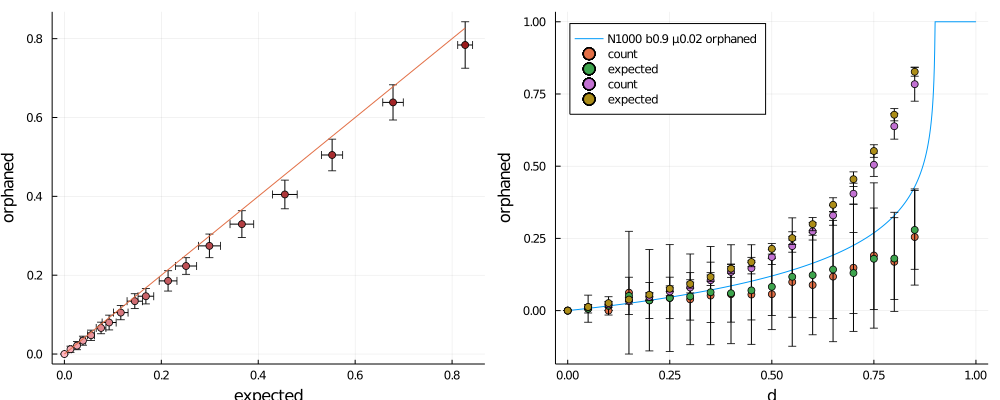

In [301]:
mcount, Δcount = [mean(countorph[i,:]) for i=1:size(countorph,1)], [std(countorph[i,:]) for i=1:size(countorph,1)]
mexp, Δexp = [mean(expectorph[i,:]) for i=1:size(expectorph,1)], [std(expectorph[i,:]) for i=1:size(expectorph,1)]

p1 = scatter(mexp, mcount, xerror = Δexp, yerror = Δcount, c=cgrad(:reds)[drange])
plot!(mexp, mexp, legend=:none, ylab=:orphaned, xlab=:expected)

p2 = scatter!(p_orph, drange, mcount, yerror = Δcount, lab="count", xlab=:d, ylab=:orphaned, legend=:topleft)
scatter!(p_orph, drange, mexp, yerror = Δexp, lab="expected", xlab=:d, ylab=:orphaned, legend=:topleft)

plot(p1,p2, size=(1000, 400))

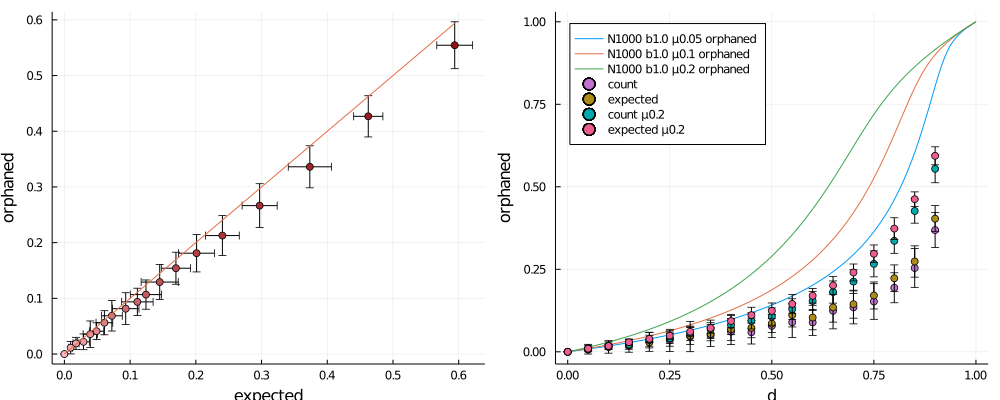

In [102]:
mcount, Δcount = [mean(countorph[i,:]) for i=1:size(countorph,1)], [std(countorph[i,:]) for i=1:size(countorph,1)]
mexp, Δexp = [mean(expectorph[i,:]) for i=1:size(expectorph,1)], [std(expectorph[i,:]) for i=1:size(expectorph,1)]

p1 = scatter(mexp, mcount, xerror = Δexp, yerror = Δcount, c=cgrad(:reds)[drange])
plot!(mexp, mexp, legend=:none, ylab=:orphaned, xlab=:expected)

p2 = scatter!(p_orph, drange, mcount, yerror = Δcount, lab="count μ$μ", xlab=:d, ylab=:orphaned, legend=:topleft)
scatter!(p_orph, drange, mexp, yerror = Δexp, lab="expected μ$μ", xlab=:d, ylab=:orphaned, legend=:topleft)

plot(p1,p2, size=(1000, 400))